# **BPIC14 Incidence Event Log Case Study**: *DyLoPro: Profiling the Dynamics of Event Logs*

## **Install related packages**

### Install all package

In [ ]:
! pip install pandas -U
! pip install DyLoPro -U

### Import all packages.

In [ ]:
from google.colab import files
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
import numpy as np
import DyLoPro as dlp
from matplotlib.patches import Rectangle

### Mount google drive to the enviroment. All files should be placed in /content/drive/MyDrive/dylopro/

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
file_path = '/content/drive/MyDrive/dylopro/'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## **Data Preprocess**

### Preprocessing the data (section 1)

In [ ]:
def preprocess_bpic2014(log):
    """Preprocess the bpic1501 event log.

    Parameters
    ----------
    log : pandas.DataFrame
        Event log.

    Returns
    -------
    log : pandas.DataFrame
        Preprocessed event log.
    """
    # Convert timestamp column
    log['time:timestamp'] = pd.to_datetime(log['time:timestamp'], format='%d-%m-%Y %H:%M:%S')
    log['time:timestamp'] = log['time:timestamp'].dt.tz_localize('UTC')

    # Convert 1 cols to object type.
    log['case:concept:name'] = log['case:concept:name'].astype('object')
    return log

### Preprocessing the data (section 2)

In [ ]:


# part 1
import pandas as pd
import DyLoPro as dlp

# part 2
path_to_bpic2014_log = file_path + "BPIC2014.csv"
log = pd.read_csv(path_to_bpic2014_log, header = 0, encoding='cp1252')
print(log.columns)

# key value: change column title to map Dylopro
title_map = {'IncidentActivity_Type': 'concept:name', 'Incident ID': 'case:concept:name',
             'DateStamp':'time:timestamp'}
log=log.rename(columns=title_map)


# preprocess:
log = preprocess_bpic2014(log)

# filter the most meaningful time period
log = log[log['time:timestamp'] >= '2013-09-01']

# part 3
categorical_casefeatures=['KM number', 'Interaction ID']
categorical_eventfeatures = ['IncidentActivity_Number','Assignment Group','concept:name']

# part 4
bpic2014_plots = dlp.DynamicLogPlots(log, case_id_key = 'case:concept:name', activity_key = 'concept:name',
                                   timestamp_key = 'time:timestamp', categorical_casefeatures = categorical_casefeatures,
                                   categorical_eventfeatures = categorical_eventfeatures, start_date = "09/01/2013")


Index(['Incident ID', 'DateStamp', 'IncidentActivity_Number',
       'IncidentActivity_Type', 'Assignment Group', 'KM number',
       'Interaction ID'],
      dtype='object')
Preprocessing the data...


/usr/local/lib/python3.10/dist-packages/DyLoPro/preprocess_utils.py:105: UserWarning: In some cases in the given log, the events were not ordered correctly based on their timestamp. In the DynamicLogPlots instance' internal representation of the log, this problem is resolved by correctly sorting the events.
  warnings.warn(warning_message)
100%|██████████| 460655/460655 [00:00<00:00, 959189.05it/s]


## **Brief Introduction**

This notebook contains an **extensive case study on the dynamics over time in the BPIC14 Incidence Event Log**. The event log records activities of a service management system in the Netherlands bank Rabobank Group ICT. It includes 46,616 cases with 466,737 events in total, ranging from 2013-01-07 to 2014-04-02. However,  most cases in the log happened after 2013-09. The original event log can be downloaded [here](https://data.4tu.nl/articles/_/12706424/1).

This notebook includes **5 sections** consisting of 1 general summarization and 4 concepts analysis. For each concept, the most interesting and obvious trends and drifts are identified and analyzed.

1.	**General Remarks and Observations**

2.	**Variants**: The dynamics observed for the variants indicate extraction bias and gradual drifts in the control-flow perspective.

3.	**Directly-Follows-Relations**: The dynamics observed for the DFRs also indicate extraction bias and gradual drifts in the control-flow perspective, as well as gradual drifts in the performance perspective.

4.	**Categorical Event Features**: The dynamics observed for the categorical event features signify diversified drifts in mostly individual levels of two significant categorical event features, representing drifts in data perspectives. In addition, varied drifts in the performance perspectives are also presented in the changes of categorical event features.

5.	**Categorical Case Features**: The dynamics observed for the categorical case features signify different types of drifts in mostly individual levels of one significant categorical case feature, representing drifts in data perspectives. In addition, varied drifts in the performance perspectives are also presented in the changes of categorical case features.


All of DyLoPro's plotting methods construct time series by deriving real-valued measures for a choronologically ordered set of sublogs. This chronologically ordered set of sublogs is constructed by:

1. Defining the `frequency` parameter, that determines the frequency by which the observations are grouped. E.g. here, for all visualizations, we use the default `frequency='weekly'`. As such, the time period covered by the entire event log is subdivided into a chronologically ordered set of weekly time intervals.

2. Defining the `case_assignment` parameter, that determines the condition upon which each case is assigned to one of these equal-length time intervals. E.g. here, for all visualizations, we use the default `case_assignment='first_event'`. As such, each case is assigned to the time interval in which its first event occurs.

Consequently, for the BPIC14 Incidence case study with `frequency='weekly'` and `case_assignment='first_event'`, each case is assigned to the 1-week time interval in which its first event occurs and hence each sublog will consist of all cases that were initialized in one particular week.


**NOTE:** For the BPIC14 Incidence plots, we use the default settings for the following common parameters unless specified otherwise:

  •	time_unit = 'days'

  •	frequency = 'weekly'

  •	case_assignment = 'first_event'

  •	max_k = 10

  •	xtr_outlier_rem = True

## **0. General observations and remarks:**

1.	Every plotting method also provides a first global overview of the amount of cases contained within each interval, and:

   •	If **representation type** = **Throughput Time (TT)** (plt_type='type_tt'): the overall throughput time aggregated over all cases contained within each time interval / sublog. (The aggregation operator is by default the mean, and can be customized by specifying the numeric_agg parameter of each plotting method.)

   •	If **representation type** = **Case Length (Number of Events per Case, aka NEPC) (plt_type='type_events_case')**: the overall case length (in NEPC) aggregated over all cases contained within each time interval / sublog. (The aggregation operator is by default the mean, and can be customized by specifying the numeric_agg parameter of each plotting method.)

2.	The default representation type of each plotting method is Isolated, but since each non-default representation type also includes the isolated time series, we only use the non-default representation types.

3.	The BPIC14 Incidence event log contains cases about a service management system in a bank from 2013-01-07 to 2014-04-02. Consequently, if we assume that only completed cases are extracted, both the beginning and ending of the event log contain some bias:

   •	**Bias in beginning** event log - By only including the cases that start after a certain point in time, the number of running cases in the beginning of the event log does not reflect the underlying actual reality. How long this bias persists in the plots depends on both the chosen **frequency (= 'weekly' in the BPIC14 Incidence case study) **and the distribution of the throughput time of cases.

   •	**Bias in ending** of the event log - By only including the **completed** cases that end (and hence are completed) before a certain point in time:

      1) The number of running cases towards the end of the event log does not reflect the underlying actual reality. Again, the amount of subsequent time intervals located near the end of the event log in which this bias is included, depends on both the chosen frequency (= 'weekly' in the BPIC14 Incidence case study) and the distribution of the **throughput time o**f cases.

      2) The average throughput time (TT) of cases towards the end of the dataset is lower than the actual reality. Among cases starting near the ending, cases with a higher TT will be more likely to end after the extraction date and will hence not be included in the event log. The amount of time intervals near the end in which this bias persists will again also depend on the chosen **frequency (= 'weekly' in the BPIC14 Incidence case study)** and the distribution of the **throughput time** of cases.

   Intervals near the beginning and end of the event log in which the number of cases is significantly smaller compared to other time intervals, might give us non-representative samples of cases, and hence yield unrepresentative aggregations. Every plotting method also provides a first global overview of the amount of cases contained within each interval. As such, unrepresentative samples near the beginning or end of the event log can easily be identified. Therefore, we will not report on deviating measurements if they pertain to such non-representative samples.

4.	**GENERAL TRENDS:**

   •	**Throughput Time (TT)**: In general, the weekly mean TT of cases gradually decreased(not obvious in general) from the start until 2014-03, when a sudden decline happened and finally reached 0.

      1) One possible explanation for the continuous decrease in the weekly mean TT of cases is that the process is continuously optimized. However, the sudden decline in weekly mean TT of cases after 2014-03, till the end of the event log, combined with the sudden decline in the case number, clearly shows there are already missing cases, resulting in the skewed distribution of the weekly mean TT.

      2) If this would be the case, the observed performance drift after 2014-03 would not correspond to an actual drift in the underlying data generating function, but rather to the extraction bias induced towards the end of the event log. If other case characteristics are correlated to the throughput time of cases, then this bias might also induce skewness in other characteristics' distributions sampled towards the end of the event log.

      3) The continuously declining gradual drifts in the weekly mean TT of cases can be observed in e.g. the weekly mean TT visualization of TT representation type in the DFRs concept.
      
   •	**Case Length (NEPC)**: In general, the weekly mean Number of Events Per Case (NEPC) decreased spirally and gradually till 2014-03, when a sudden decrease happened. If a case's throughput time and NEPC would be correlated, then the same bias could be a plausible explanation for this trend. The spiral and sudden decline can be observed in e.g. the mean NEPC visualization of NEPC representation type in the DFRs concept.



## **1. Variants concept analysis:**

The BPIC14 Incidence contains around 43,000 variants, among which, the individual fraction of all the cases with the 10 most frequent variants accounts for no more than 5% of the whole case volume. Therefore, the underlying process can be regarded as a rather unstructured process, and consequently, it is not easy to examine the overall control-flow trends, patterns or changes by means of individual variants. But analyzing individual variants can still be interesting if they show obvious changes.

As the visualization of TT and isolated representation type shows, there seems to be some interesting changes in individual variants: To be specific(except the extraction bias at the beginning and the end): 1) in 2014-01, fractions of cases with variant 5-10 occurred and increased gradually to be one of the 10 most common variants(gradual drift in control-flow perspective); 2) in 2014-02, fractions of case with variant 5 decreased gradually(gradual drift in control-flow perspective).


In [ ]:
# part 5-1 variants
var_df = bpic2014_plots.get_var_df(max_k = 10, counts = True)
print(var_df.to_string())

                                                                    variant  variant count
variant number                                                                            
1                                              (Open, Closed, Caused By CI)           1751
2                                              (Open, Caused By CI, Closed)           1643
3                                  (Open, Assignment, Closed, Caused By CI)           1085
4                                  (Open, Assignment, Caused By CI, Closed)            985
5                   (Open, Assignment, Status Change, Closed, Caused By CI)            723
6                   (Open, Assignment, Status Change, Caused By CI, Closed)            702
7                   (Open, Status Change, Assignment, Closed, Caused By CI)            684
8                   (Open, Status Change, Assignment, Caused By CI, Closed)            628
9               (Open, Status Change, Assignment, Mail to Customer, Closed)            510

Computing additional weekly Throughput Time aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 36.82it/s]


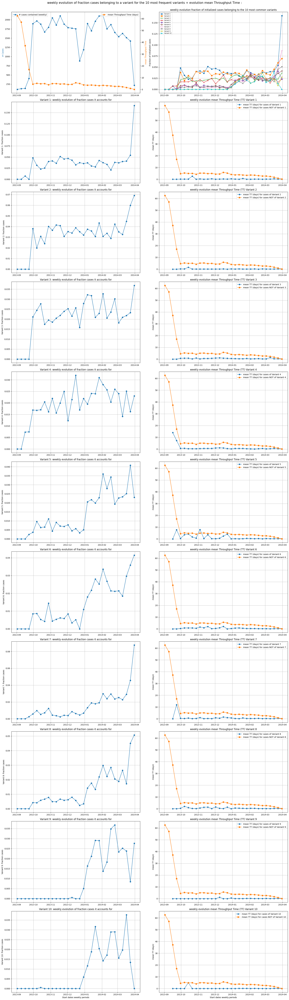

In [ ]:
# part 5-2 Throughput Time of variants
bpic2014_plots.topK_variants_evol(max_k = 10, plt_type = 'type_tt', xtr_outlier_rem = False)

## **2. DFRs concept analysis:**

When analyzing the dynamics over time for the top 10 most frequently occurring DFRs. The following interesting trends, patterns and changes were identified:

In the log, around 40% of cases contain DFR 1, 2 and 3, around 35% of cases contain DFR 7-9, and around 30% of cases contain DFR 10. This shows a relatively fixed DFRs order and thus, analyzing the overall control-flow trends or changes by means of individual DFRs can be representative.

As the visualization of TT, NEPC, DFR performance, and isolated representation type shows, there seems to be an obvious correlation between the control-flow(i.e. the fractions of cases with different DFRs) and the performance of cases(i.e. the TT, NEPC, and DFR performance). To be specific(except the extraction bias at the beginning and the end): **1)** in 2013-12, fractions of cases with DFR 1, 2, and 7-9 fluctuated (change in control-flow perspective) when the weekly mean TT of total and individual mean TT of the related DFRs, the weekly mean NEPC of total and mean NEPC of most individual DFRs, and the DFR performance of most individual DFRs fluctuated as well(change in performance perspective); **2)** in 2014-01, fractions of cases with DFR 2 and 7-10 decreased gradually while DFR 4 and 5 increased gradually(gradual drift in control-flow perspective) when the weekly mean TT of all cases and individual weekly mean TT of cases with DFR 4 and 5, as well as the mean NEPC of all and individual mean NEPC of cases with DFR 4 and 5 decreased gradually. Besides, the DFRs performance of cases with DFR 2 and DFR 7-10 either suddenly or gradually increased(sudden/gradual drift in performance perspective); **3)** in 2014-02, fractions of cases with all individual DFRs and the total case volume fluctuated (change in control-flow perspective) when the weekly mean TT of total and individual mean TT of most DFRs, the weekly mean NEPC of total and mean NEPC of most individual DFRs, and the DFR performance of most individual DFRs fluctuated as well(change in performance perspective).


In [ ]:
# part 6-1 DFRs- sequence
dfr_df = bpic2014_plots.get_DFR_df(max_k = 10, counts = True)
print(dfr_df.to_string())

                                        DFR  DFR count
DFR number                                            
1               (Assignment, Status Change)      18599
2                (Reassignment, Assignment)      17357
3                    (Closed, Caused By CI)      17128
4                        (Open, Assignment)      16370
5                    (Caused By CI, Closed)      15956
6               (Status Change, Assignment)      15904
7             (Assignment, Operator Update)      15642
8                (Assignment, Reassignment)      14357
9             (Operator Update, Assignment)      14352
10          (Reassignment, Operator Update)      11960


Computing additional weekly Throughput Time aggregations for each of the 10 most frequently occurring DFRs: 100%|██████████| 10/10 [00:00<00:00, 19.10it/s]


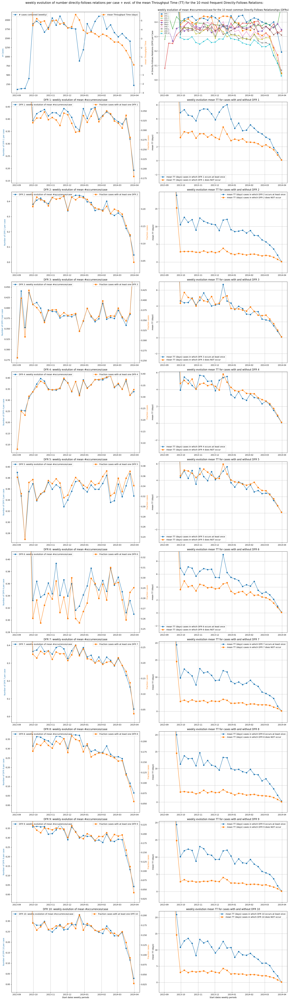

In [ ]:
# part 6-2 DFRs-TT
bpic2014_plots.topK_dfr_evol(plt_type = 'type_tt', max_k = 10)

Computing additional weekly aggregations of the amount of events per case for each of the 10 most frequently occurring DFRs: 100%|██████████| 10/10 [00:00<00:00, 22.87it/s]


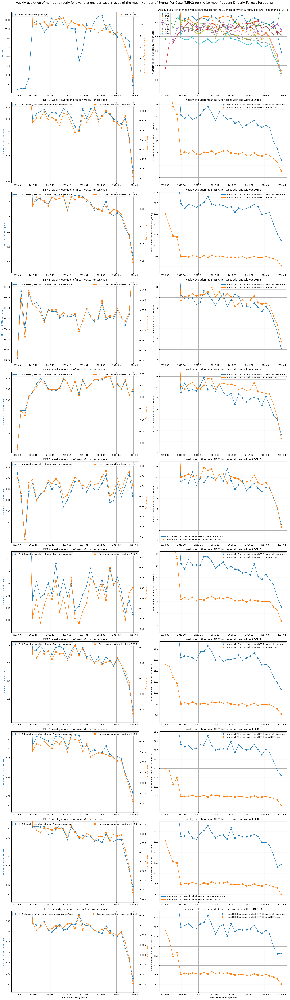

In [ ]:
# part 6-3 DFRs- NEPC
bpic2014_plots.topK_dfr_evol(plt_type = 'type_events_case')

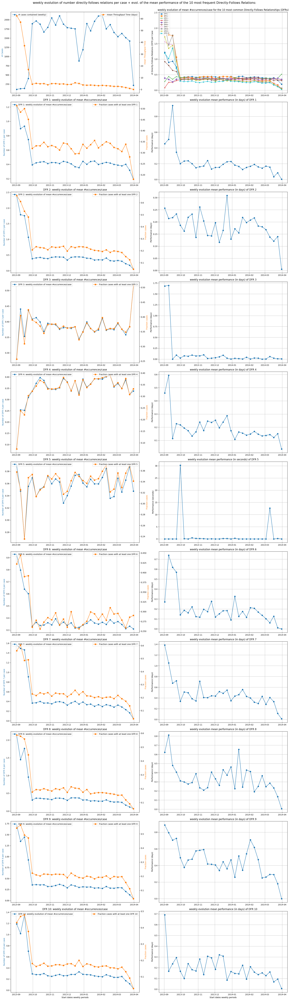

In [ ]:
# part 6-4 DFRs- DFRs performance
bpic2014_plots.topK_dfr_evol(plt_type = 'type_dfr_performance', xtr_outlier_rem = False)

## **3. Categorical event features concept analysis:**

Within the 3 categorical event features in the event log, we find two event features (the **“concept:name”** and the **“Assignment Group”** ) present obvious changes and interesting patterns:

When analyzing the interesting trends in the two categorical event features, we find in the weekly fractions of cases with most common levels, there are dominant levels in both features: in the “concept:name” event feature, cases with the level “Open” and “Closed” appears in almost all cases, “Assignment” accounts for 80%, “Caused by CI” accounts for 70%, “Status Change” accounts for 65%, “Operator Update” and “Reassignment” account for 40%, “Update” accounts for 30%, and “Quality indicator Fixed” and “Communication with Customer” account for 10%; in the “Assignment Group” event feature, level 1 accounts for 70% and most others accounts for about 10%. Thus, analyzing the overall data-perspective trends or changes by means of individual categorical event feature levels can also be representative.   

As the visualization of TT, NEPC, and isolated representation type shows, there seems to be an obvious correlation between the data(i.e. the fractions of different levels of a categorical event feature) and the performance of cases(i.e. the TT, NEPC, and outcome). To be specific(except the extraction bias at the beginning and the end):

In the categorical event feature **“concept:name”**, we find interesting correlations between data and performance perspectives as follows:

**1)** in 2013-11, the fraction of cases with level “Quality indicator Fixed” increased suddenly(sudden drift in data perspective), and in the meantime, its NEPC decreased suddenly and its mean TT decreased gradually(sudden/gradual drift in performance perspective); **2)** in 2014-01, the fraction of cases with level “Quality indicator Fixed” decreased suddenly(sudden drift in data perspective), and in the meantime, its NEPC and its mean TT increased gradually(gradual drift in performance perspective).

In the categorical event feature **“Assignment Group”**, we find interesting correlations between data and performance perspectives as follows:

in 2014-01, the fraction of cases with level 2 increased gradually(gradual drift in data perspective), and in the meantime, its NEPC and its mean TT decreased gradually(gradual drift in performance perspective).

In addition, in 2013-11, we also find an independent gradual drift in the data perspective as it shows a gradual increase in the fraction of cases with level 1.

### categorical event feature - concept:name

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 21.79it/s]


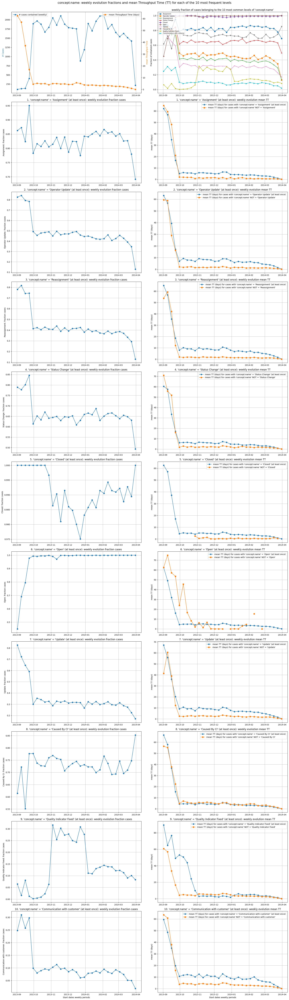

In [ ]:
# part 7-1 categorical event feature - TT
bpic2014_plots.topK_categorical_eventftr_evol(event_feature='concept:name', plt_type = 'type_tt', xtr_outlier_rem = False)

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 22.51it/s]


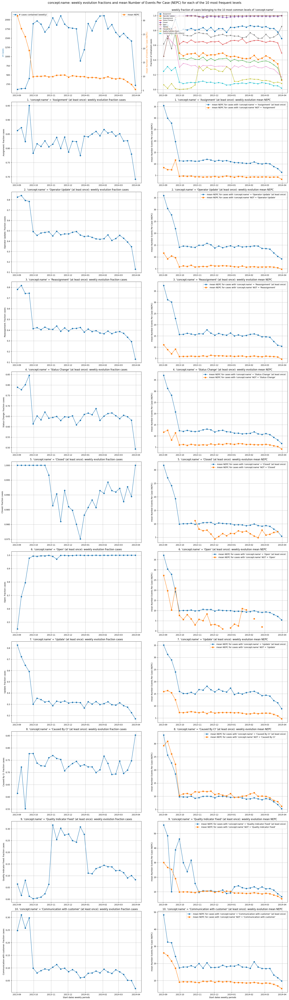

In [ ]:
# part 7-2 categorical event feature - NEPC
bpic2014_plots.topK_categorical_eventftr_evol(event_feature='concept:name', plt_type = 'type_events_case', xtr_outlier_rem = False)

### categorical event feature - IncidentActivity_Number

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'IncidentActivity_Number': 100%|██████████| 10/10 [00:00<00:00, 29.98it/s]


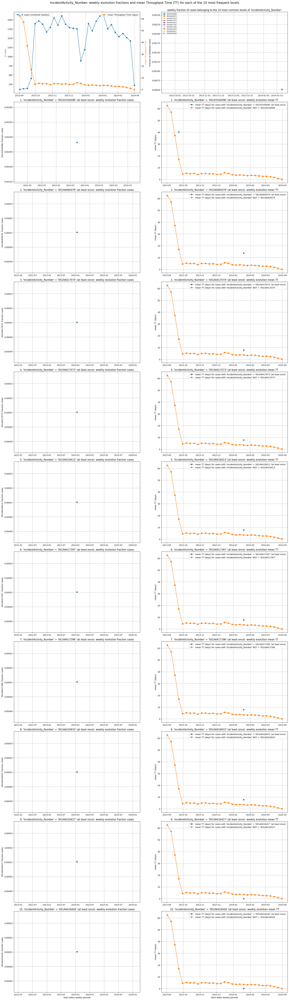

In [ ]:
# part 8-1 categorical event feature - TT
bpic2014_plots.topK_categorical_eventftr_evol(event_feature='IncidentActivity_Number', plt_type = 'type_tt', xtr_outlier_rem = False)

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'IncidentActivity_Number': 100%|██████████| 10/10 [00:00<00:00, 20.44it/s]


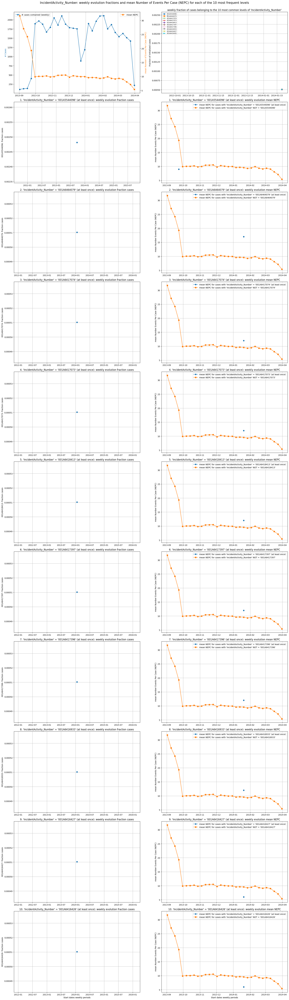

In [ ]:
# part 8-2 categorical event feature - NEPC
bpic2014_plots.topK_categorical_eventftr_evol(event_feature='IncidentActivity_Number', plt_type = 'type_events_case', xtr_outlier_rem = False)

### categorical event feature - Assignment Group

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'Assignment Group': 100%|██████████| 10/10 [00:00<00:00, 22.65it/s]


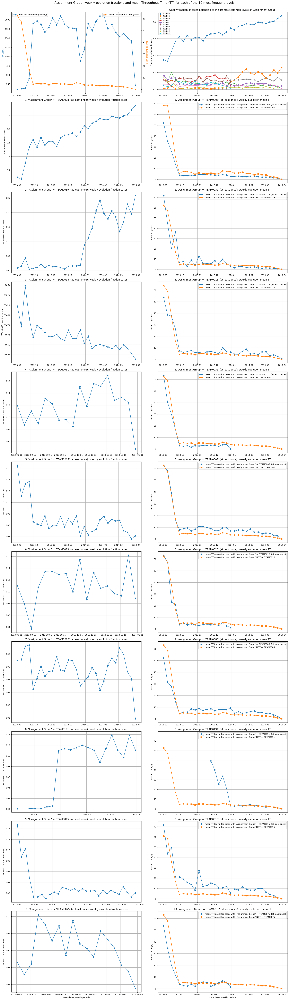

In [ ]:
# part 9-1 categorical event feature - TT
bpic2014_plots.topK_categorical_eventftr_evol(event_feature='Assignment Group', plt_type = 'type_tt', xtr_outlier_rem = False)

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'Assignment Group': 100%|██████████| 10/10 [00:00<00:00, 23.97it/s]


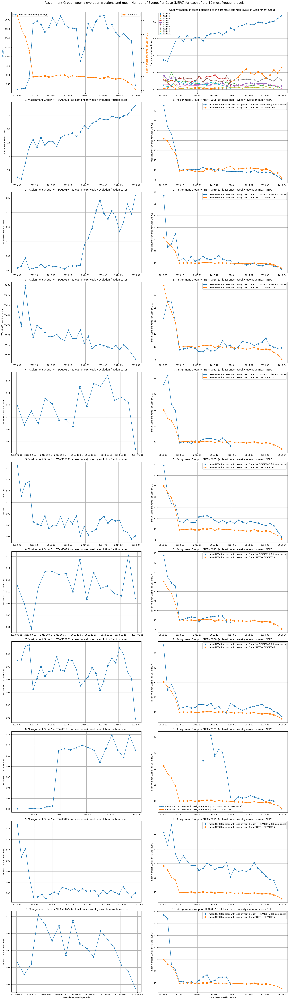

In [ ]:
# part 9-2 categorical event feature - NEPC
bpic2014_plots.topK_categorical_eventftr_evol(event_feature='Assignment Group', plt_type = 'type_events_case', xtr_outlier_rem = False)

## **4. Categorical case features concept analysis:**

In both the two categorical case features of the log, we find the individual fraction of all cases with the 10 most frequent levels accounts very low in the total. Therefore, the underlying process can be regarded as a rather unstructured process, and consequently, it is not easy to examine the overall data trends, patterns or changes by means of individual categorical case features. But analyzing individual categorical case features can still be interesting if they show obvious changes.

Within the 2 categorical case features in the event log, we find the case feature **“KM number”** presents obvious changes and interesting correlations between data and performance perspectives:

**1)** in 2013-10, the fraction of cases with level 4 increased suddenly(sudden drift in data perspective), and in the meantime, its NEPC increased suddenly (sudden drift in performance perspective); **2)** in 2014-01, the fraction of cases with most individual levels and the total case volume increased suddenly(sudden drift in data perspective), and in the meantime, the mean NEPC of total and mean TT of total decreased gradually(gradual drift in performance perspective). Besides the general trend, in the individual level, we find a sudden decrease in the fraction of cases with level 7(sudden drift in data perspective) and a gradual increase of the NEPC of cases with level 7(gradual drift in performance perspective).


### categorical case feature - KM number

Computing additional weekly aggregations of the Throughput Time for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 19.52it/s]


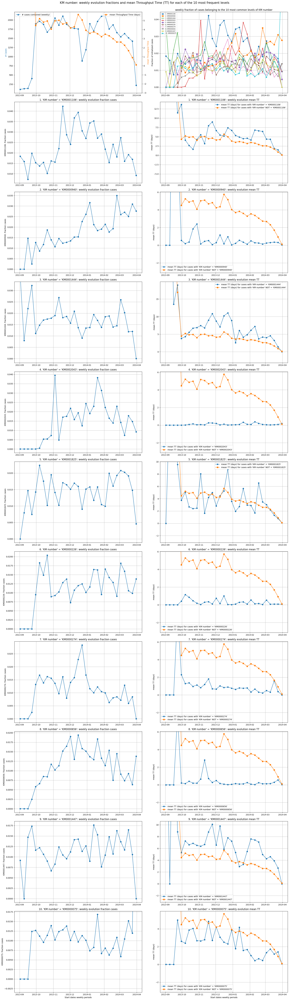

In [ ]:
# part 10-1 categorical case feature - TT
bpic2014_plots.topK_categorical_caseftr_evol(case_feature = 'KM number', frequency = 'weekly', plt_type = 'type_tt')

Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 23.76it/s]


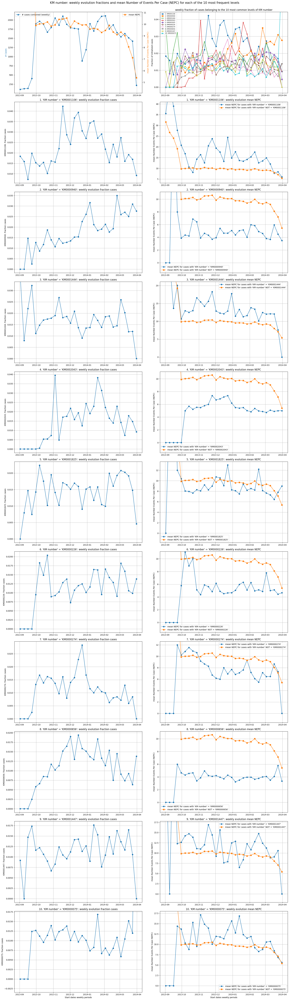

In [ ]:
# part 10-2 categorical case feature - NEPC
bpic2014_plots.topK_categorical_caseftr_evol(case_feature = 'KM number', plt_type = 'type_events_case')

### categorical case feature - Interaction ID

Computing additional weekly aggregations of the Throughput Time for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 22.92it/s]


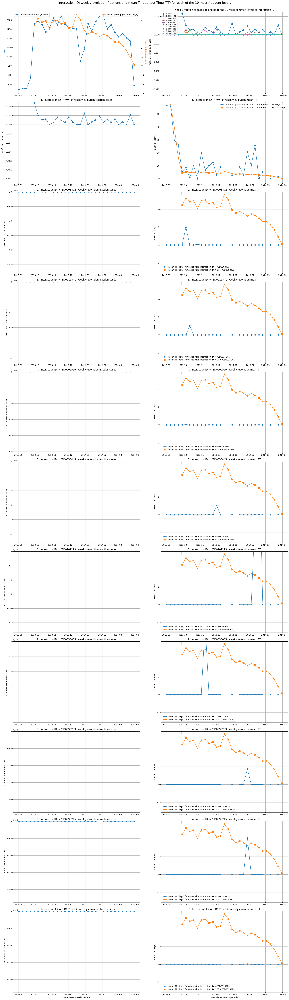

In [ ]:
# part 11-1 categorical case feature - TT
bpic2014_plots.topK_categorical_caseftr_evol(case_feature = 'Interaction ID', frequency = 'weekly', plt_type = 'type_tt')

Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 22.10it/s]


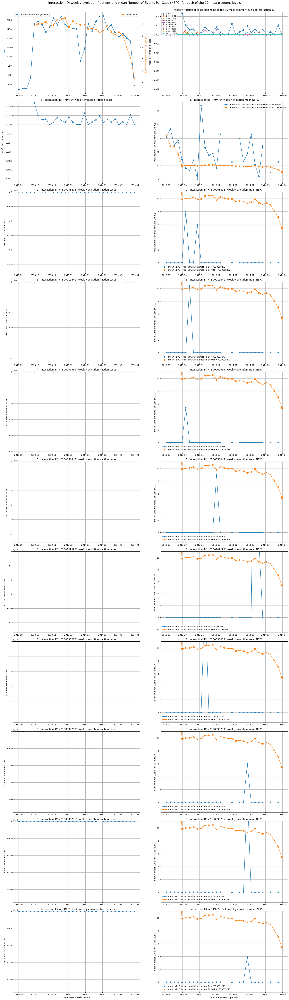

In [ ]:
# part 11-2 categorical case feature - NEPC
bpic2014_plots.topK_categorical_caseftr_evol(case_feature = 'Interaction ID', plt_type = 'type_events_case')